## ROC Analysis



In [7]:
from pynwb import NWBHDF5IO
from nwbwidgets import nwb2widget
from nwbwidgets.allen import AllenRasterWidget
from nwbwidgets.allen import AllenPSTHWidget
import pandas as pd
import numpy as np
import ast
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from auc_analysis import *

pd.set_option('display.max_columns', None)  # Show all columns
pd.set_option('display.max_rows', 10)  # Show all columns

mouse_name = 'AB077_20230531_143839' #'AB087_20231017_141901'


In [8]:
#df = pd.read_parquet(f'{mouse_name}_Selectivity_Dataframe.parquet')
df = pd.read_parquet('/Users/shrinidhivelan/Desktop/Selectivity-Semester-project/Data/AB077_20230531_143839/AB077_20230531_143839_Selectivity_Dataframe.parquet')

# Saving the files

In [ ]:
# Example usage
whisker_pre = df["whisker_pre_spikes"]
whisker_post = df["whisker_post_spikes"]
cluster_id = df["cluster_id"]

save_roc_plots(whisker_pre, whisker_post, cluster_id, "whisker", mouse_name)

In [26]:
auditory_pre = df["auditory_pre_spikes"]
auditory_post = df["auditory_post_spikes"]
cluster_id = df["cluster_id"]

save_roc_plots(auditory_pre, auditory_post, cluster_id, "auditory")


In [27]:
cluster_id = df["cluster_id"]
whisker_post = df["whisker_post_spikes"]
auditory_post = df["auditory_post_spikes"]

save_roc_plots(whisker_post, auditory_post, cluster_id, "wh_aud")

In [28]:
cluster_id = df["cluster_id"]
lick_stim_pre = df["lick_stim_pre_spikes"]
lick_stim_post = df["lick_stim_post_spikes"]

save_roc_plots(lick_stim_pre, lick_stim_post, cluster_id, "lick_stim")

# Start by looking at neurons

## 1) ROC pre vs post whisker stimulation model


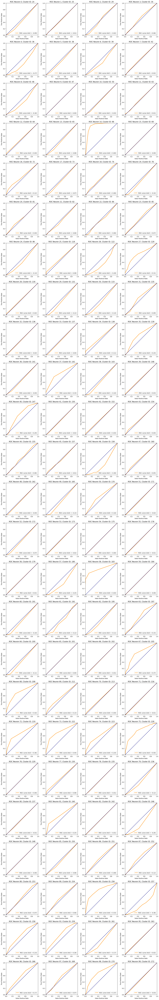

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc


# Example usage
whisker_pre = df["whisker_pre_spikes"]
whisker_post = df["whisker_post_spikes"]
cluster_id = df["cluster_id"]


plot_subplots(whisker_pre, whisker_post, cluster_id, "whisker", 4, 100)
#def plot_subplots(whisker_pre, whisker_post, cluster_ID, type="Whisker", plots_per_row = 4, total_plots = 40):


## 2) ROC pre vs post Auditory stimulation model


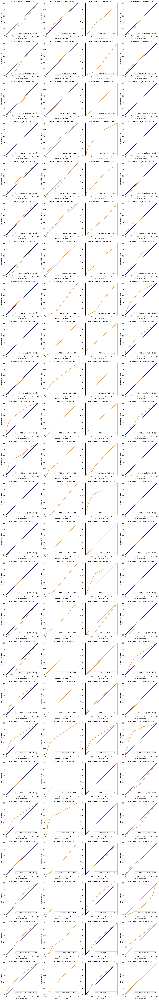

In [ ]:
auditory_pre = df["auditory_pre_spikes"]
auditory_post = df["auditory_post_spikes"]

cluster_id = df["cluster_id"]

plot_subplots(auditory_pre, auditory_post, cluster_id, "auditory", 4, 100)#, 4, len(cluster_id))


## 3) Whisker post vs Auditory post 

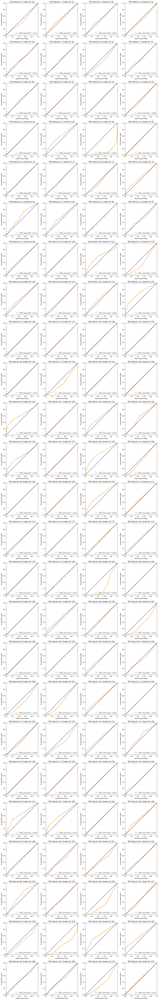

In [ ]:
# We shall consider with both variables

whisker_post = df["whisker_post_spikes"]
auditory_post = df["auditory_post_spikes"]
cluster_id = df["cluster_id"]

# Plot ROC curves for row 4 and row 12
plot_subplots(whisker_post, auditory_post, cluster_id, "wh/aud",4,100)

## 4) Lick_stim pre vs post

In [ ]:
# We shall consider with both variables

lick_stim_post = df["lick_stim_post_spikes"]
lick_stim_post = df["lick_stim_post_spikes"]
cluster_id = df["cluster_id"]

# Plot ROC curves for row 4 and row 12
plot_subplots(whisker_post, auditory_post, cluster_id, "lick_stim",4,100)

## Now let's create a new column for the AUC of each of the types computed above :

In [9]:
df['whisker_AUC'] = df.apply(lambda row: compute_AUC(row, "whisker"), axis=1)
df['auditory_AUC'] = df.apply(lambda row: compute_AUC(row, "auditory"), axis=1)
df['wh/aud_AUC'] = df.apply(lambda row: compute_AUC(row, "wh/aud"), axis=1)
df['lick_stim_AUC'] = df.apply(lambda row: compute_AUC(row, "lick_stim"), axis=1)

# transformed AUC
df['Transformed whisker_AUC'] = df.apply(lambda row: 2*row['whisker_AUC']-1, axis=1)
df['Transformed auditory_AUC'] = df.apply(lambda row: 2*row['auditory_AUC']-1, axis=1)
df['Transformed wh/aud AUC'] = df.apply(lambda row: 2*row['wh/aud_AUC']-1, axis=1)
df['Transformed lick_stim AUC'] = df.apply(lambda row: 2*row['lick_stim_AUC']-1, axis=1)

### Plot Interesting Whisker pre vs post plots

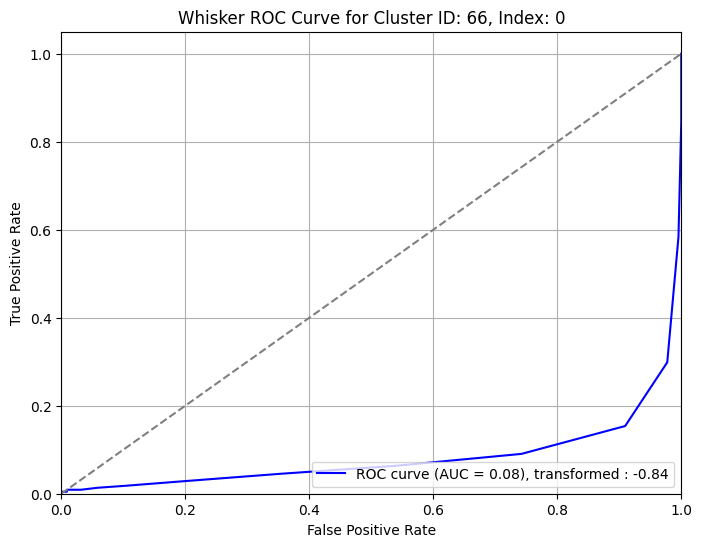

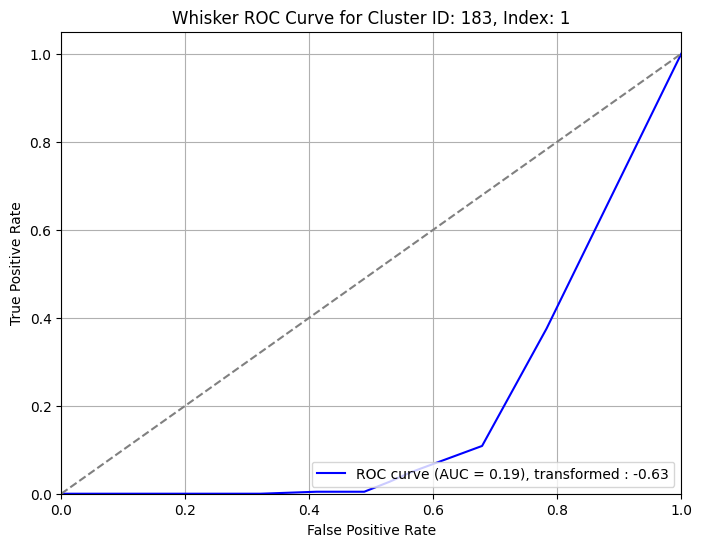

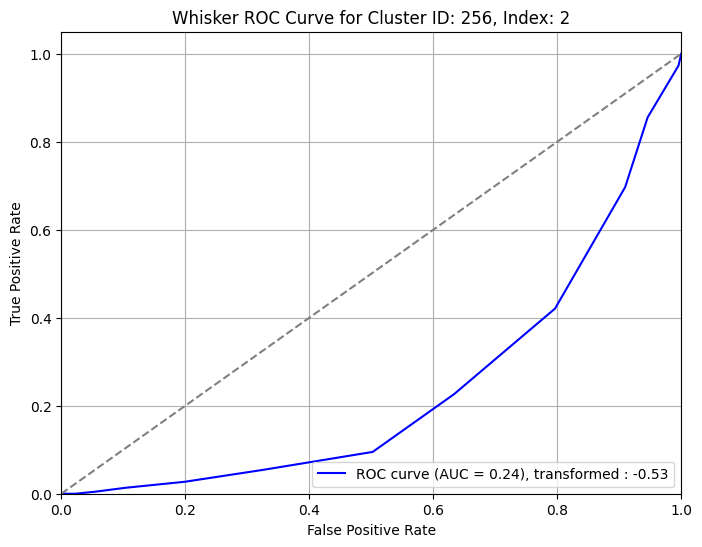

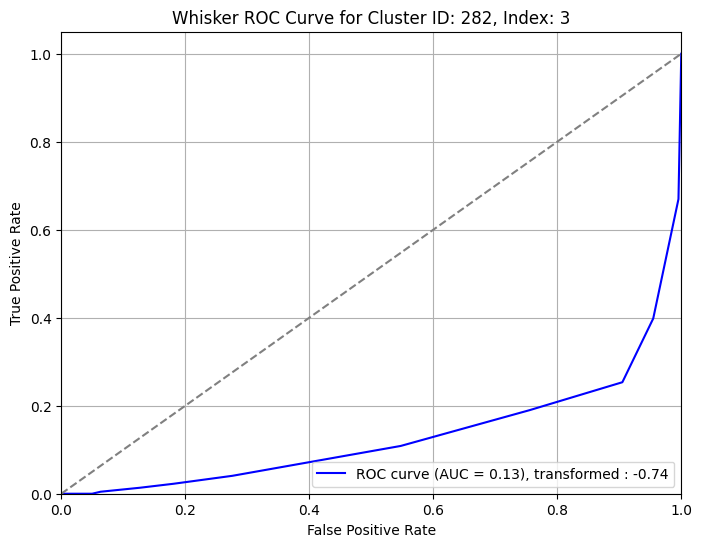

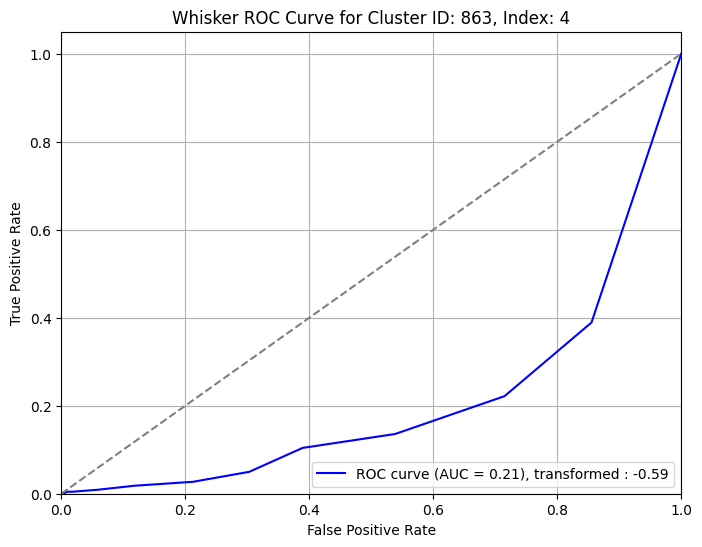

...

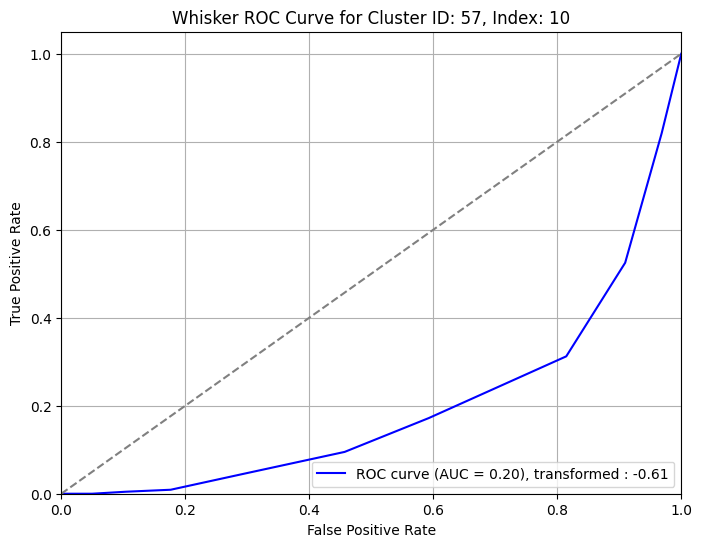

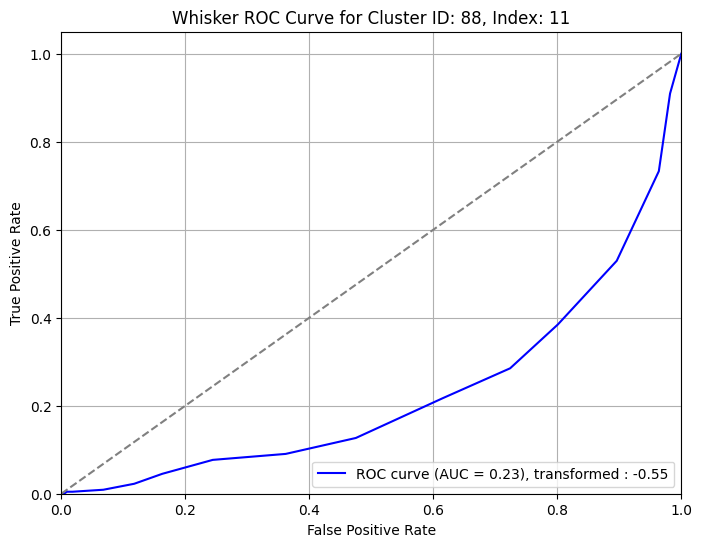

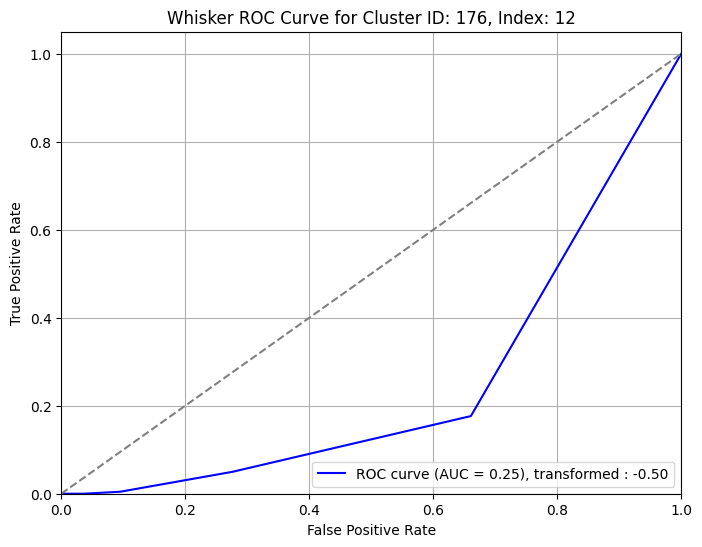

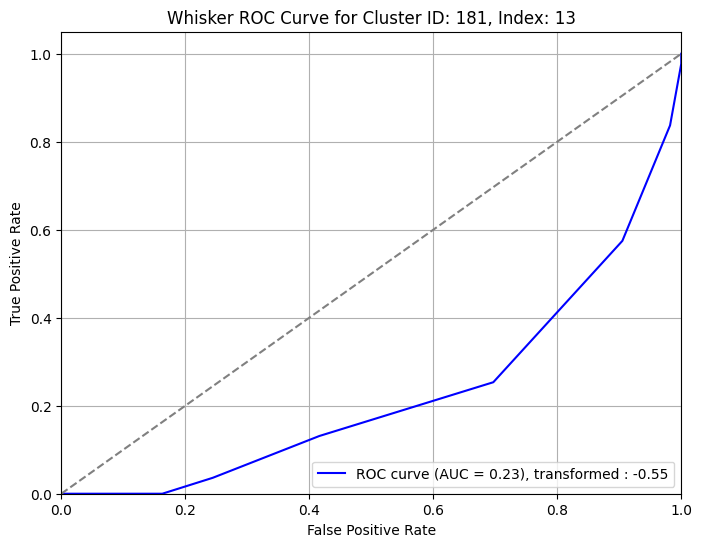

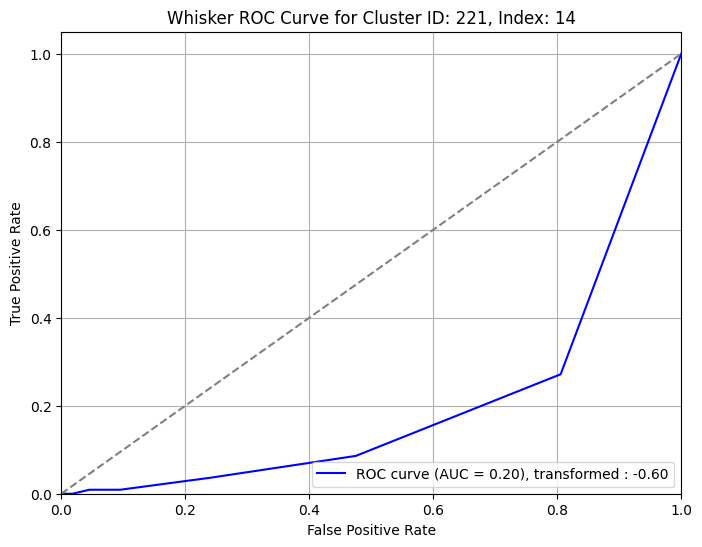

In [ ]:
interesting_whisker_AUC = df[abs(df["Transformed whisker_AUC"])>0.5]
interesting_auditory_AUC = df[abs(df["Transformed auditory_AUC"])>0.5]
interesting_wa_AUC = df[abs(df["Transformed wh/aud AUC"])>0.5]
interesting_ls_AUC = df[abs(df["Transformed lick_stim AUC"])>0.5]

for i in range(len(interesting_whisker_AUC)):
    plot_single_roc(
        interesting_whisker_AUC["whisker_pre_spikes"].iloc[i], 
        interesting_whisker_AUC["whisker_post_spikes"].iloc[i], 
        interesting_whisker_AUC["cluster_id"].iloc[i], 
        index=i
    )

### Plot Interesting Auditory pre vs post plots

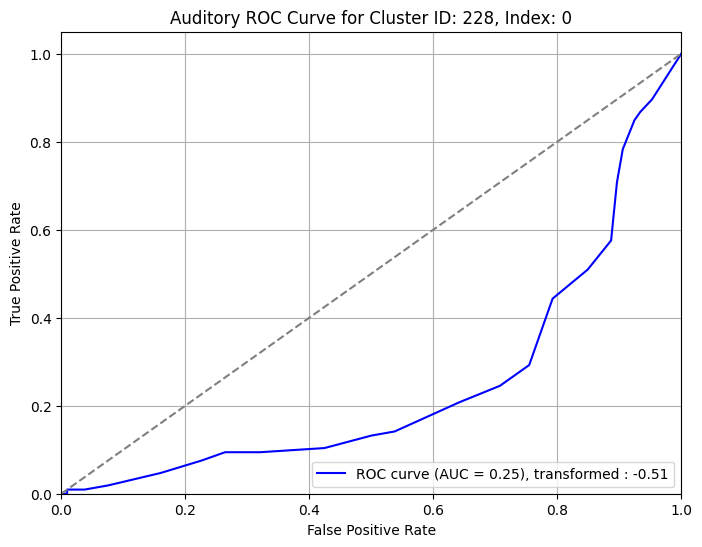

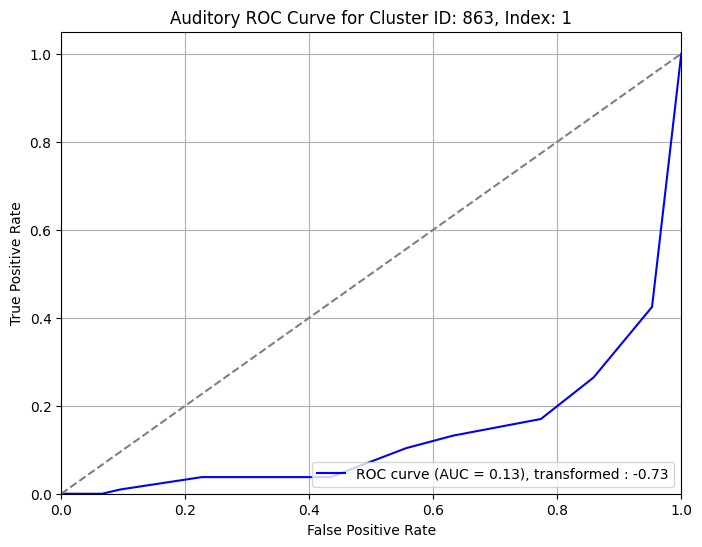

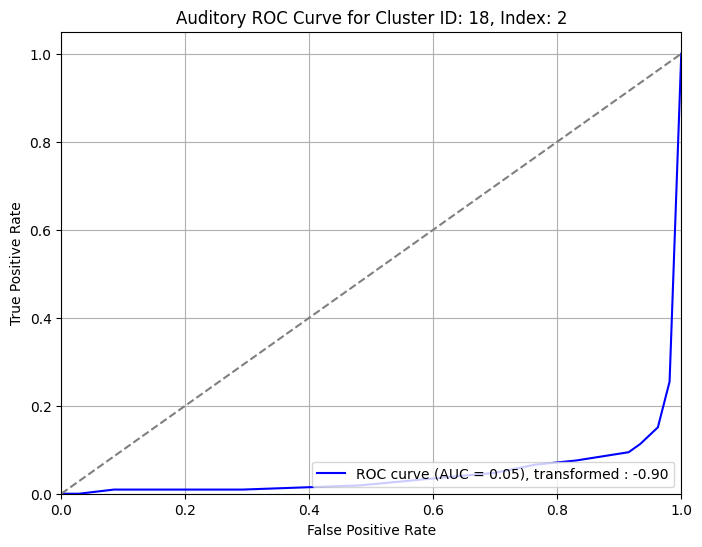

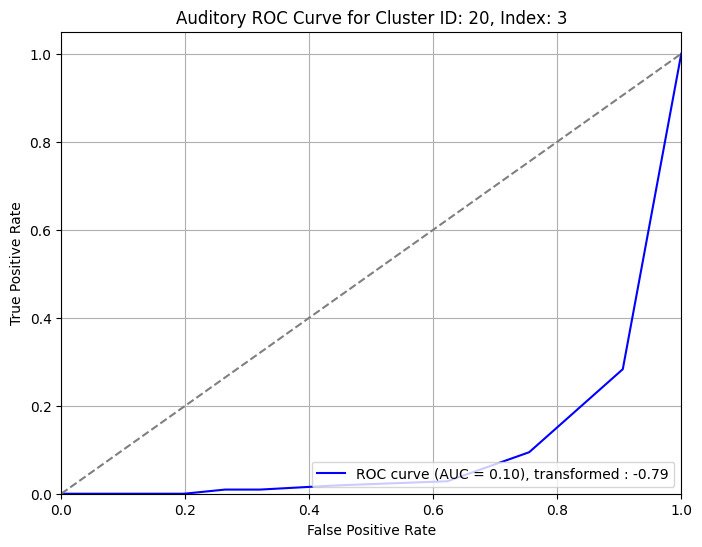

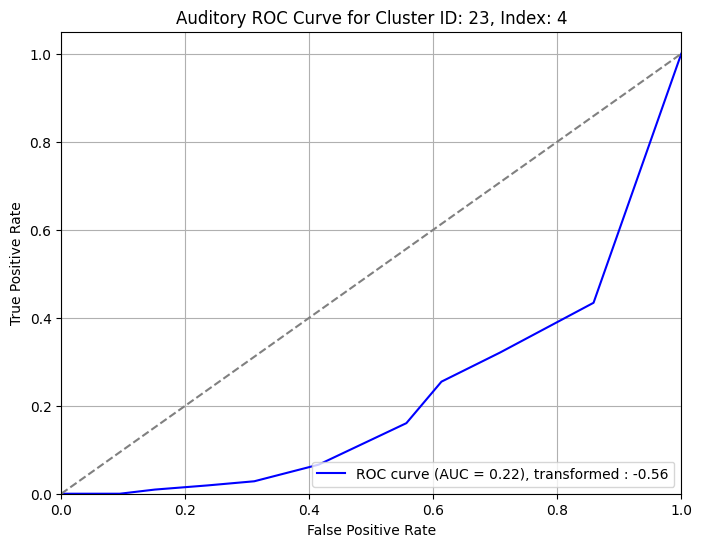

...

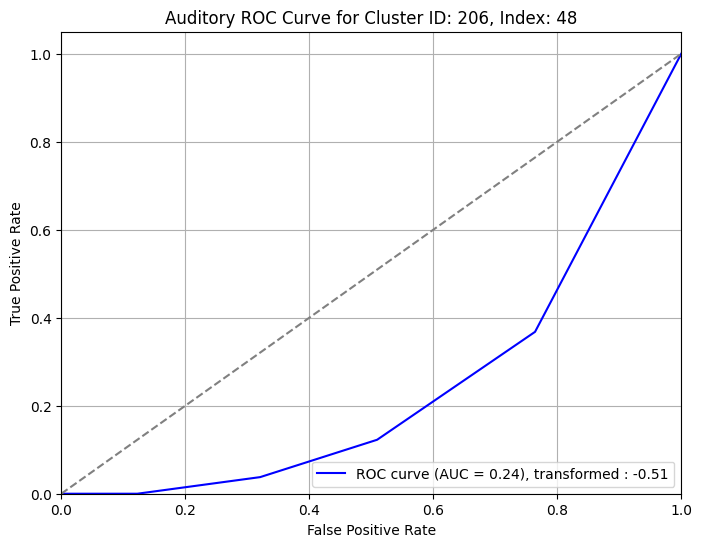

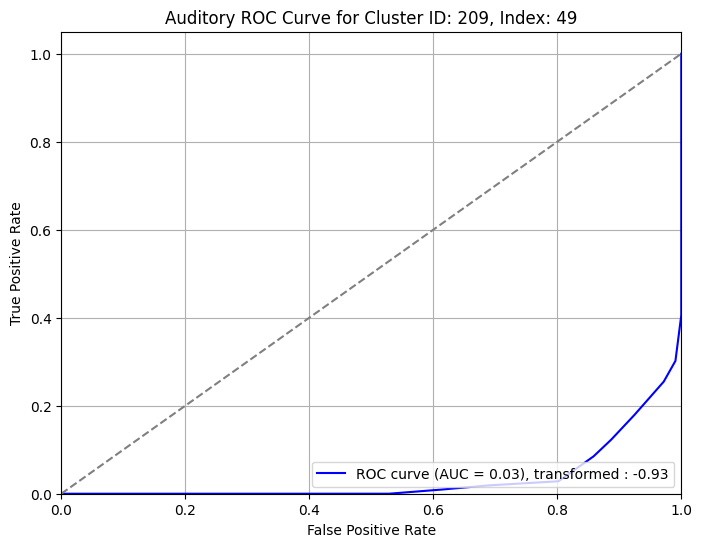

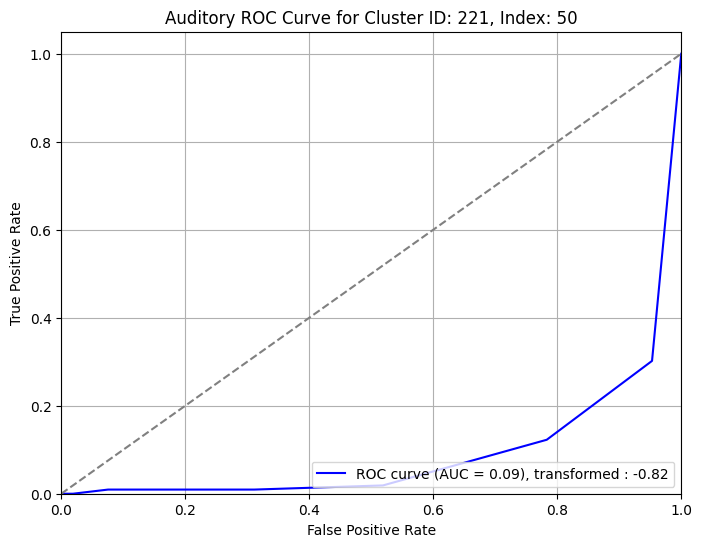

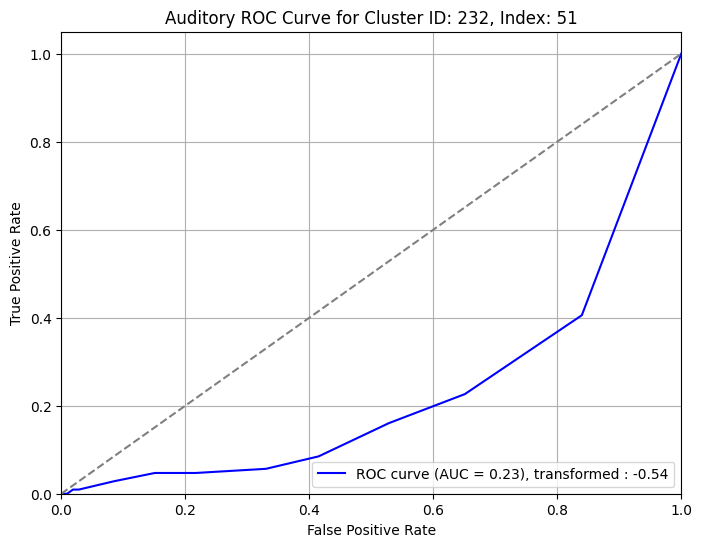

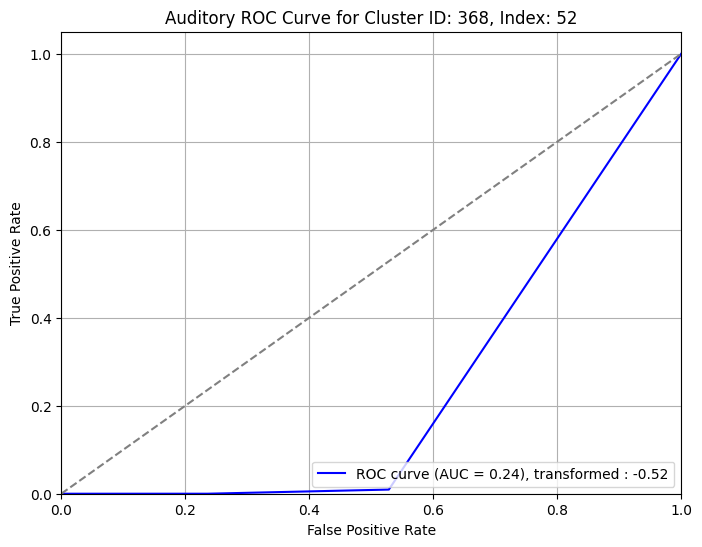

In [ ]:
for i in range(len(interesting_auditory_AUC)):
    plot_single_roc(
        interesting_auditory_AUC["auditory_pre_spikes"].iloc[i], 
        interesting_auditory_AUC["auditory_post_spikes"].iloc[i], 
        interesting_auditory_AUC["cluster_id"].iloc[i], 
        index=i, type = "auditory"
    )

### Plot Interesting Whisker post vs Auditory post plots

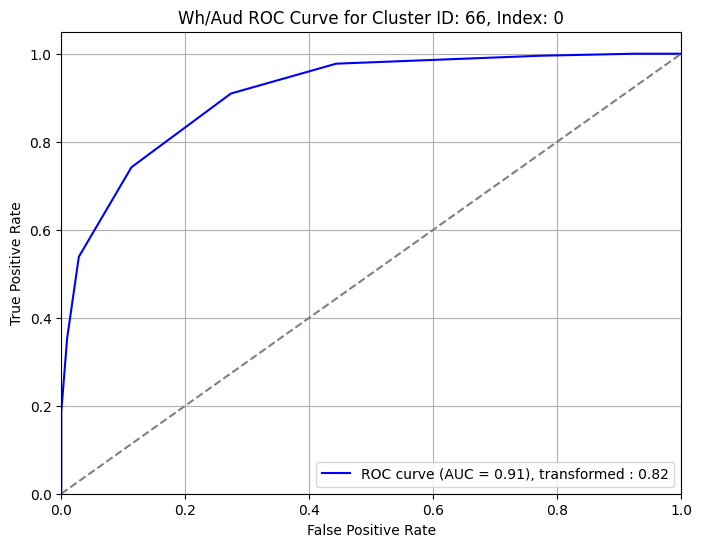

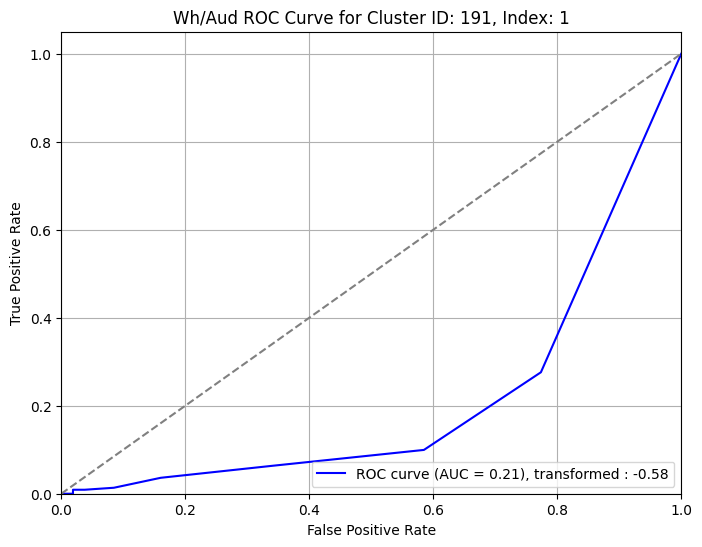

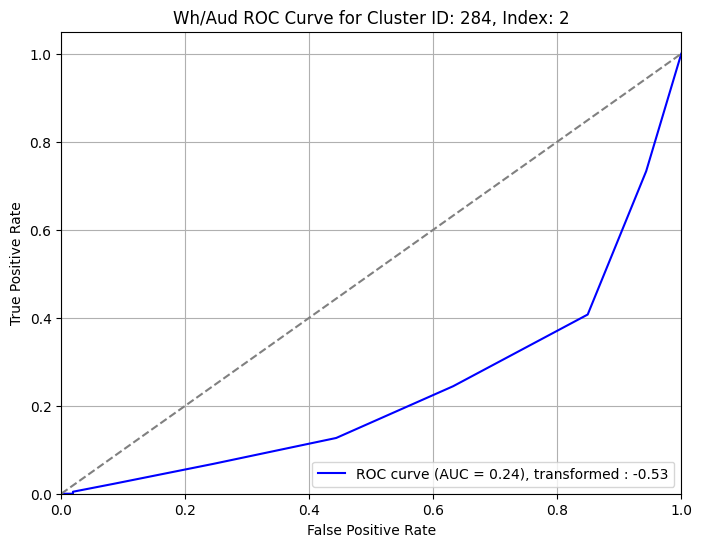

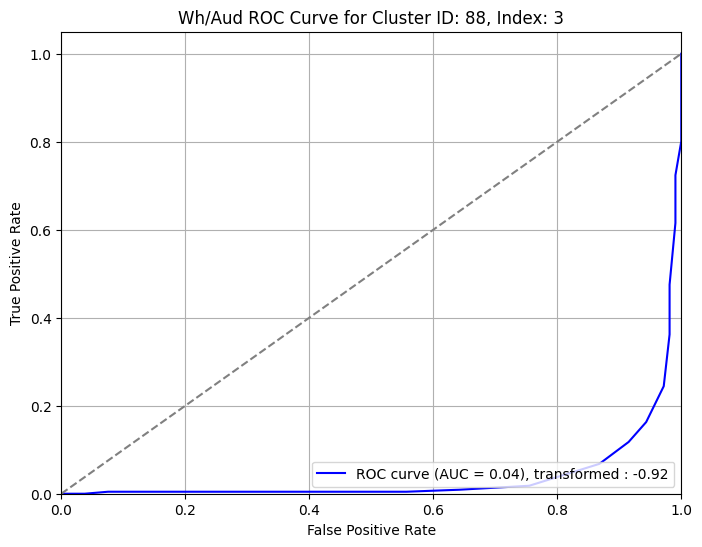

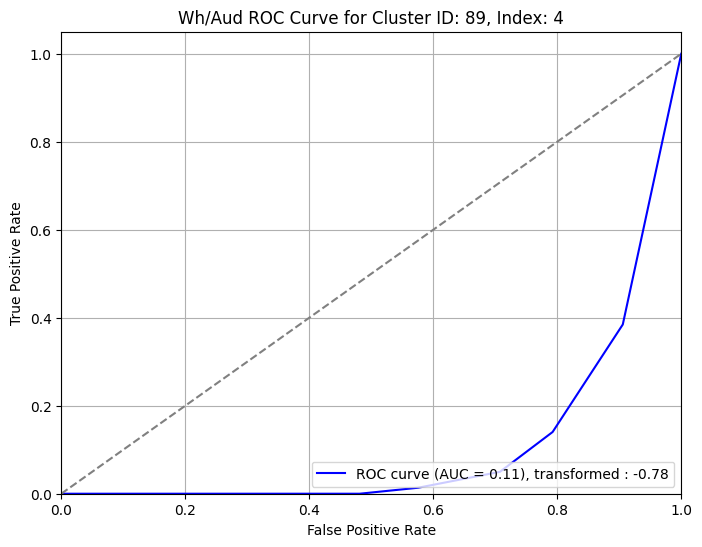

...

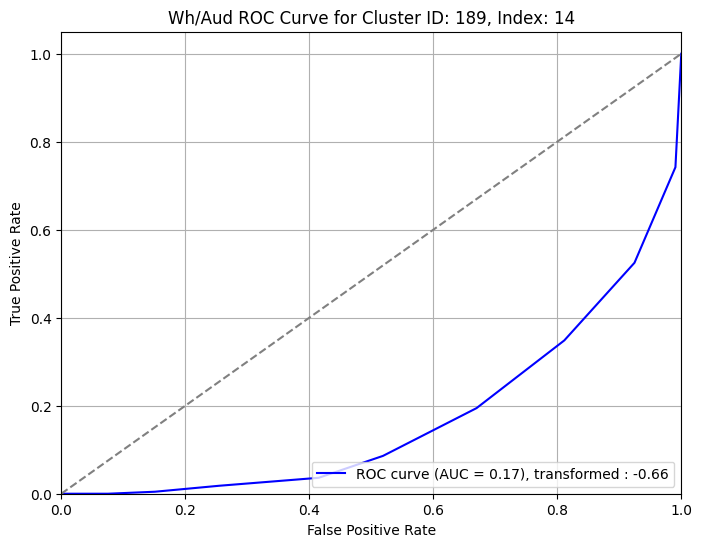

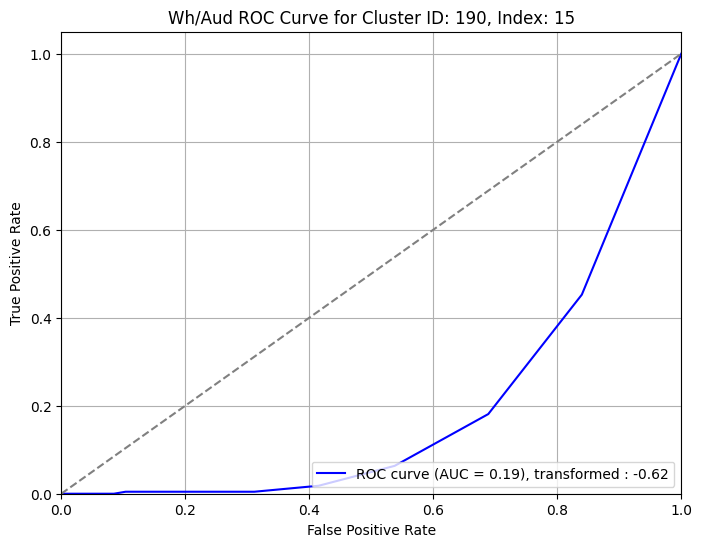

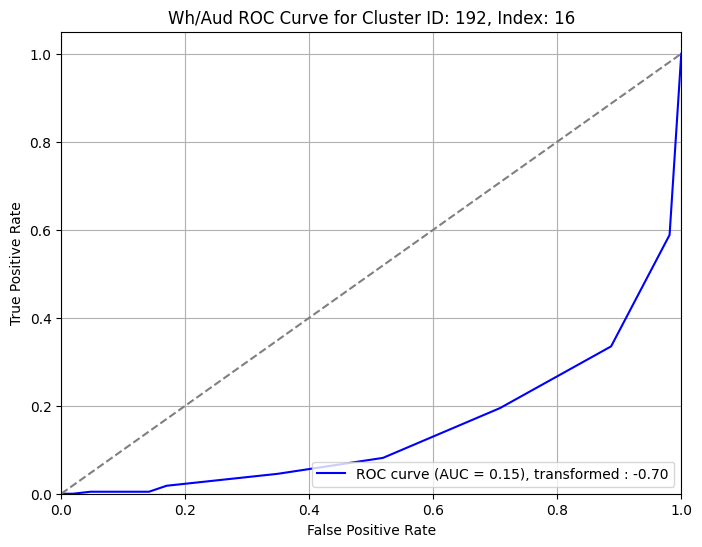

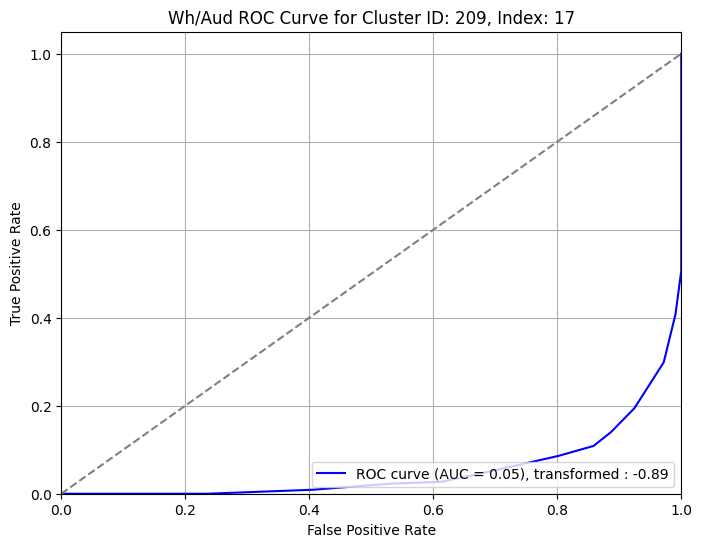

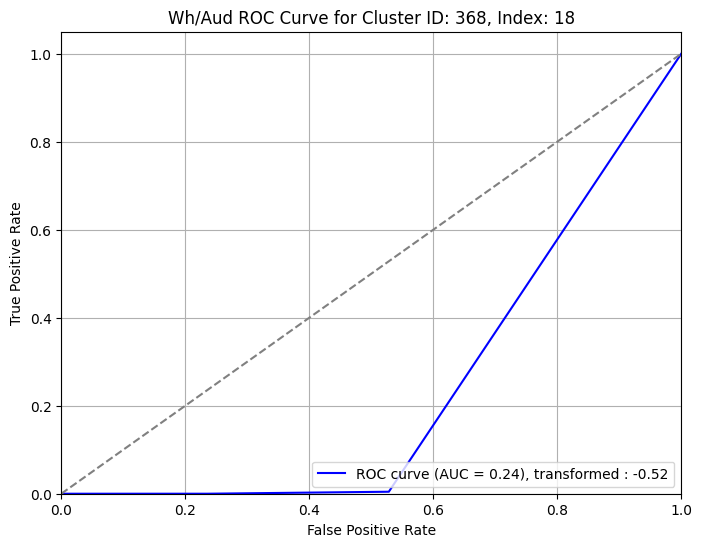

In [ ]:
for i in range(len(interesting_wa_AUC)):
    plot_single_roc(
        interesting_wa_AUC["whisker_post_spikes"].iloc[i], 
        interesting_wa_AUC["auditory_post_spikes"].iloc[i], 
        interesting_wa_AUC["cluster_id"].iloc[i], 
        index=i, type = "wh/aud"
    )

In [ ]:
#plot_roc_curve(axes[i - start_index], whisker_pre, whisker_post, i, cluster_id, type)

## Bootstrap 

#### Concept : 

(Compute the Original AUC) First, calculate the AUC for your original data as you have been doing.

(Bootstrap Resampling) Randomly shuffle your labels (pre/post) using np.random.permutation().
For each bootstrap iteration, calculate the AUC with the shuffled labels.
Repeat this process for a specified number of iterations (e.g., 1000 times).


Calculate p-value: After you have all the AUCs from the bootstrap samples, calculate how many of these AUCs are greater than or equal to your original AUC. The proportion of these values will give you the p-value.


Why is it calculated? 
To assess the stability and significance of the AUC (Area Under the Curve) metric calculated from the ROC (Receiver Operating Characteristic) curve. The purpose of bootstrapping here is to provide a way to estimate the variability of the AUC and determine if the observed AUC is significantly different from random chance.

p-values computation : compare the original AUC value obtained from the data with the distribution of AUC values generated by the bootstrap samples
Compute the AUC for each of these shuffled datasets. Store each AUC value in a list to create a distribution of AUCs under the null hypothesis.
Determine the proportion of bootstrap AUC values that are greater than or equal to the original AUC. This proportion represents the probability of observing an AUC as extreme as (or more extreme than) the original under the null hypothesis.

Mathematically, if N is the number of bootstrap iterations and AUC is the list of AUC values from bootstrapping, the p-value can be calculated as: $$p-value =  \frac{\sum{AUC}_{boot} ≥ {AUC}_{og}}{N}$$


In [ ]:
p_values_pos_whisker, p_values_neg_whisker, bootstrap_aucs_whisker, original_aucs_whisker = perform_bootstrap_roc_analysis(df["whisker_pre_spikes"], df["whisker_post_spikes"], df["cluster_id"], 1000, "whisker")

In [32]:
p_values_pos_auditory, p_values_neg_auditory, bootstrap_aucs_auditory, original_aucs_auditory = perform_bootstrap_roc_analysis(df["auditory_pre_spikes"], df["auditory_post_spikes"], df["cluster_id"], 1000, "auditory")

Processing Clusters: 100%|██████████| 557/557 [01:47<00:00,  5.20it/s]


In [33]:
p_values_pos_wh_aud, p_values_neg_wh_aud, bootstrap_aucs_wh_aud, original_aucs_wh_aud = perform_bootstrap_roc_analysis(df["whisker_post_spikes"], df["auditory_post_spikes"], df["cluster_id"], 1000, "wh/aud")

Processing Clusters: 100%|██████████| 557/557 [01:47<00:00,  5.20it/s]


In [34]:
p_values_pos_lick_stim, p_values_neg_lick_stim, bootstrap_aucs_lick_stim, original_aucs_lick_stim = perform_bootstrap_roc_analysis(df["lick_stim_post_spikes"], df["lick_stim_post_spikes"], df["cluster_id"], 1000, "lick_stim")

Processing Clusters: 100%|██████████| 557/557 [02:14<00:00,  4.13it/s]


In [ ]:
df = create_columns_p_values(df, 'whisker', p_values_pos_whisker, p_values_neg_whisker)
df = create_columns_p_values(df, 'auditory', p_values_pos_auditory, p_values_neg_auditory)
df = create_columns_p_values(df, 'wh/aud', p_values_pos_wh_aud, p_values_neg_wh_aud)
df = create_columns_p_values(df, 'lick_stim', p_values_pos_lick_stim, p_values_neg_whisker)


### Interesting Auditory plots for bootstrapping

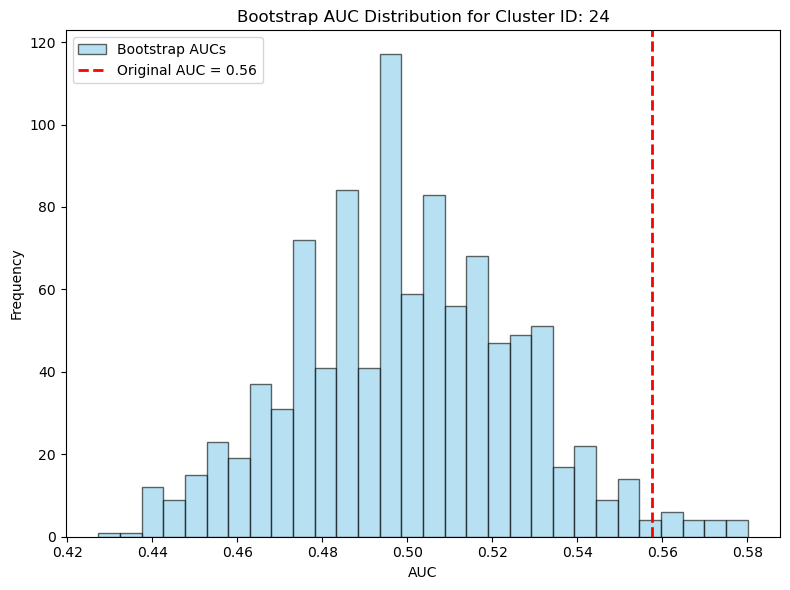

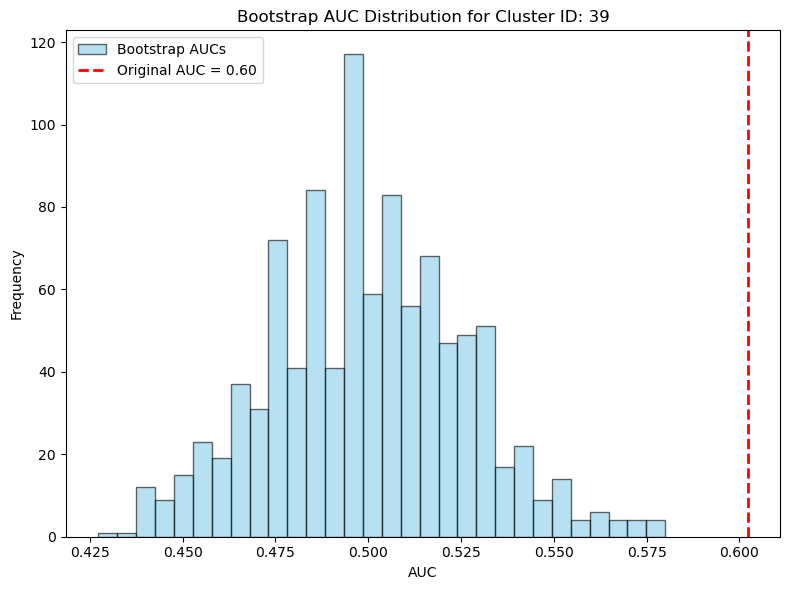

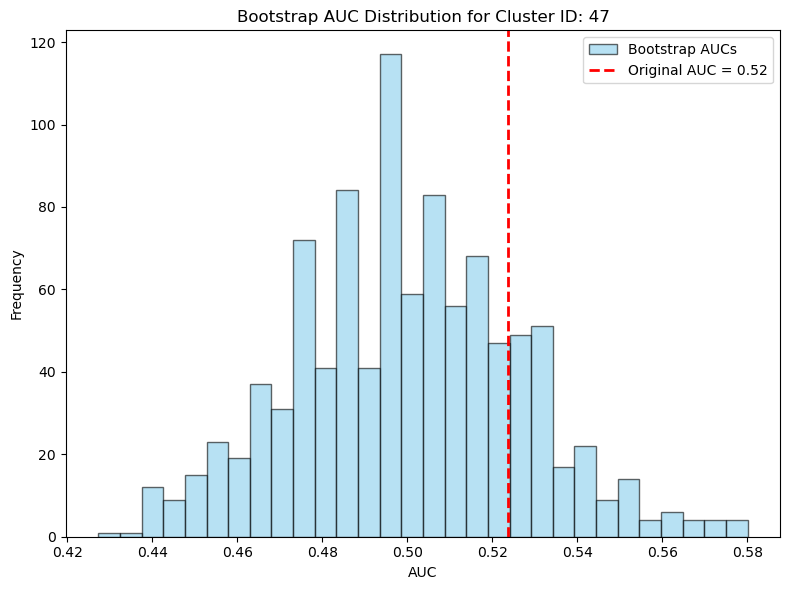

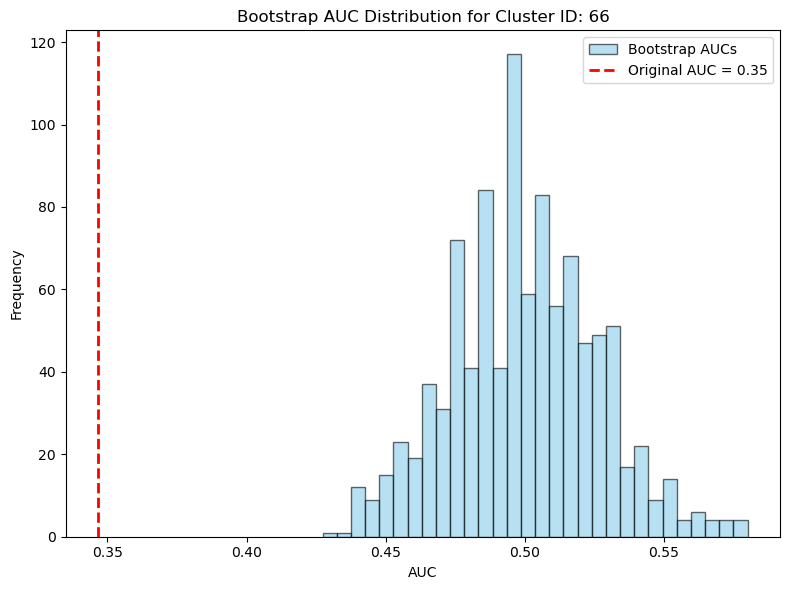

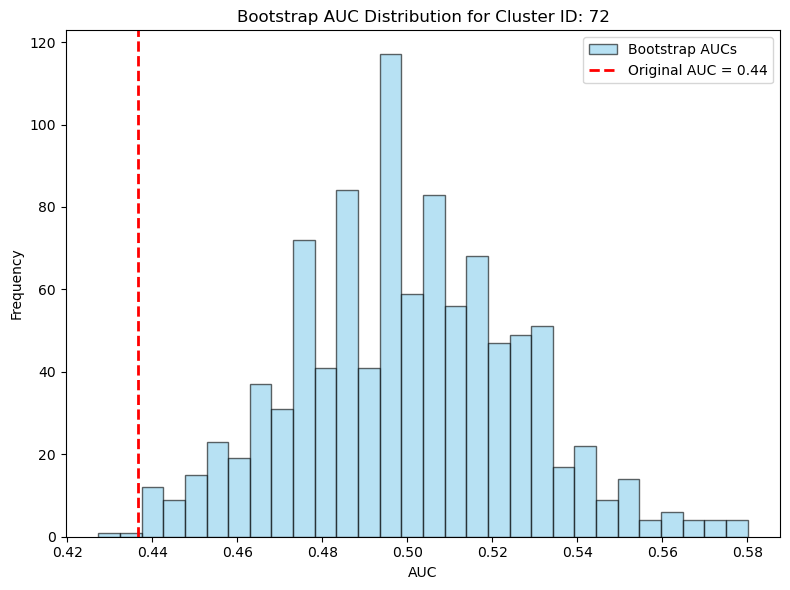

...

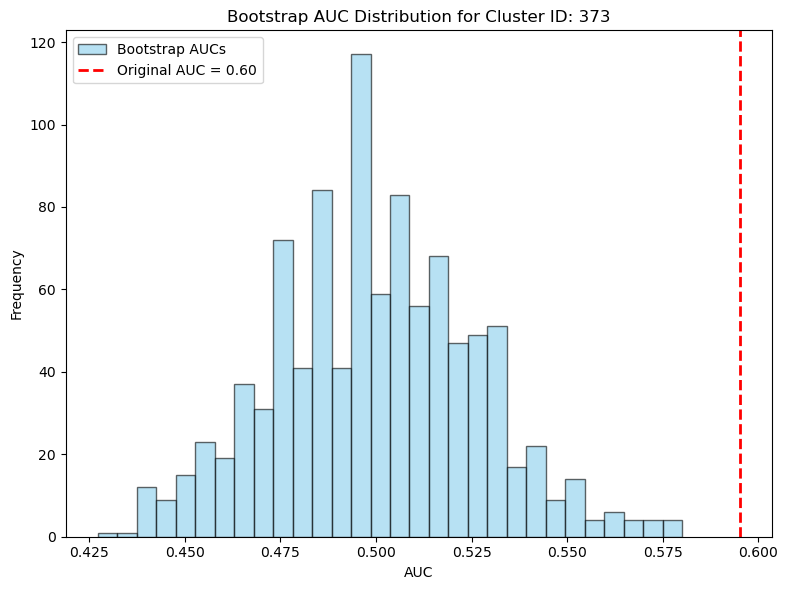

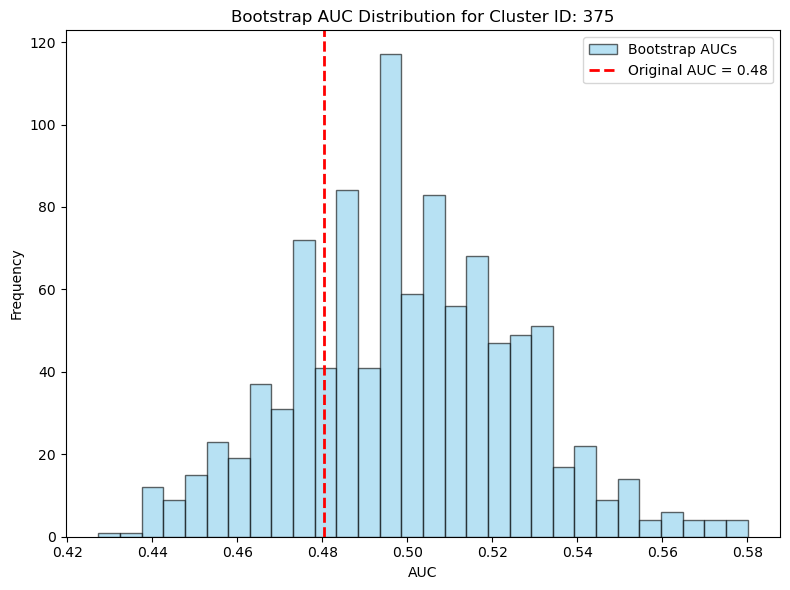

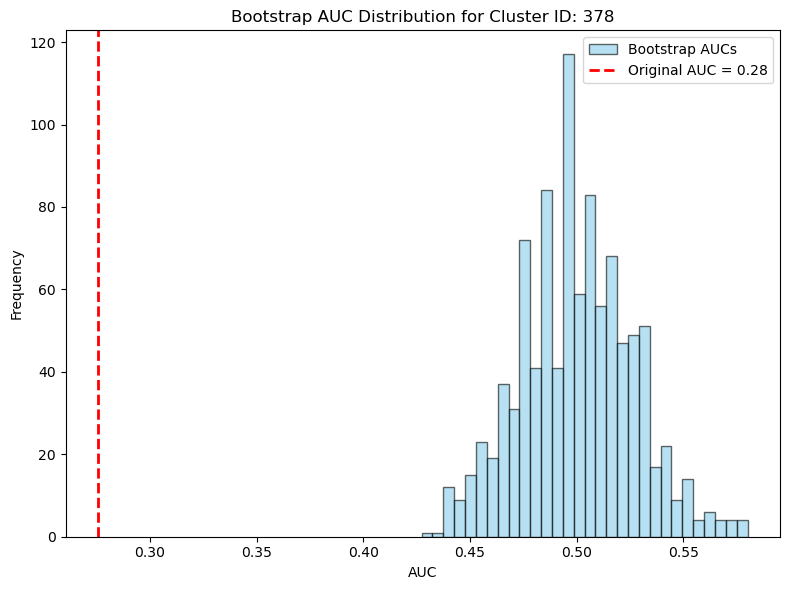

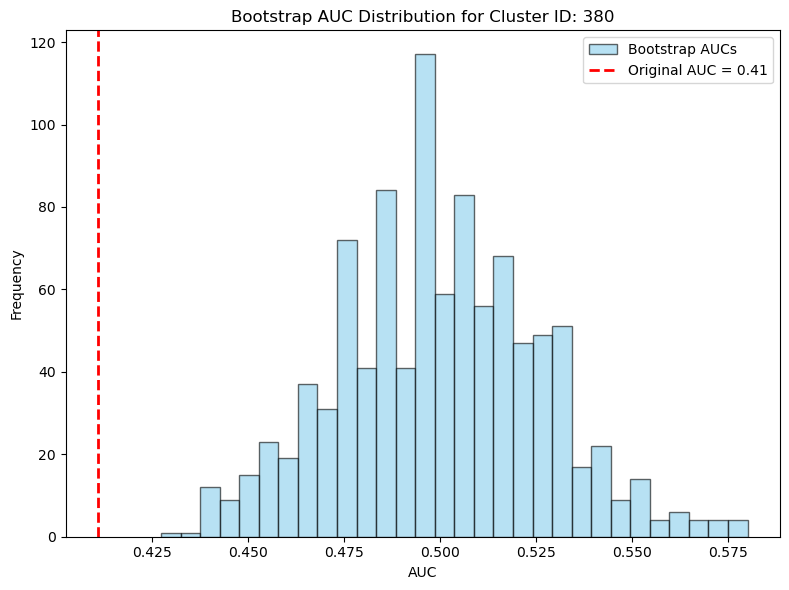

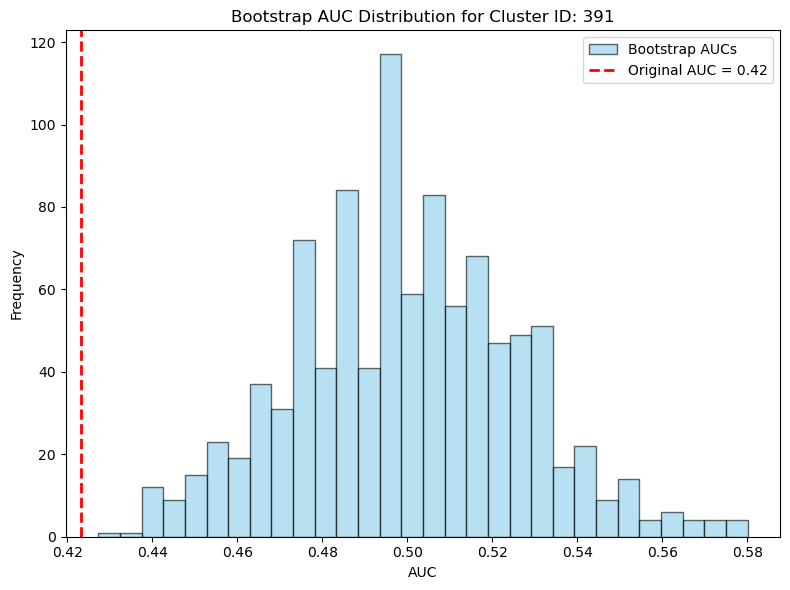

In [ ]:
interesting_auditory_clusters = df[df['selective auditory']==True]['cluster_id'].values
interesting_whisker_clusters = df[df['selective whisker']==True]['cluster_id'].values
interesting_wa_clusters = df[df['selective wh/aud']==True]['cluster_id'].values


for i in interesting_auditory_clusters:
    plot_bootstrap_auc_distribution(bootstrap_aucs_auditory, original_aucs_auditory, df["cluster_id"], i)
    

### Interesting Whisker plots for bootstrapping

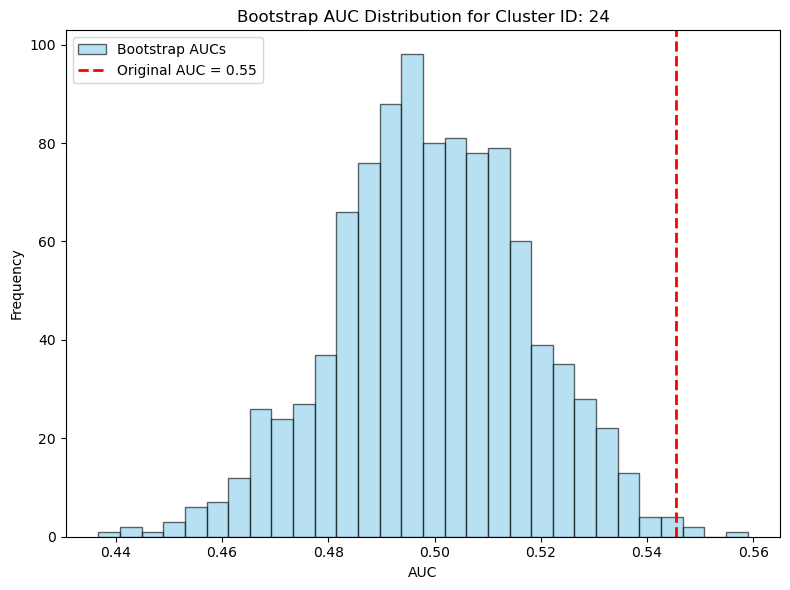

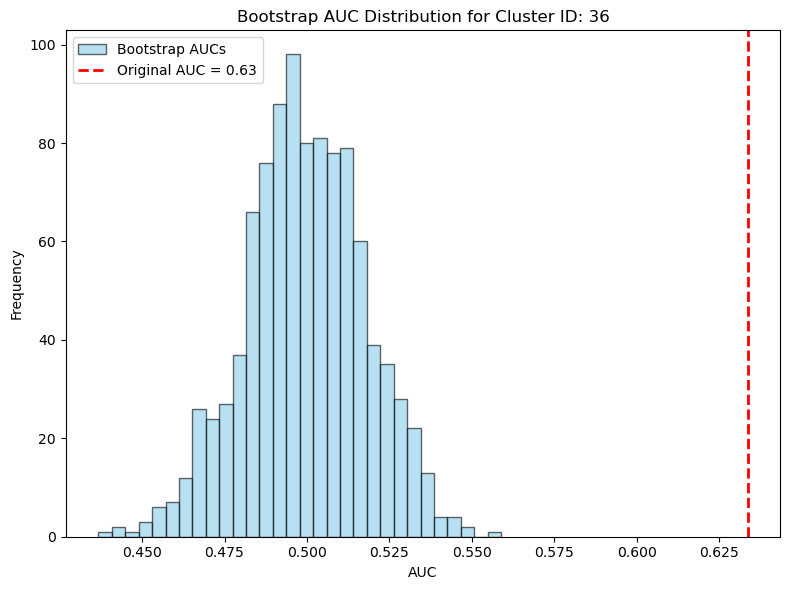

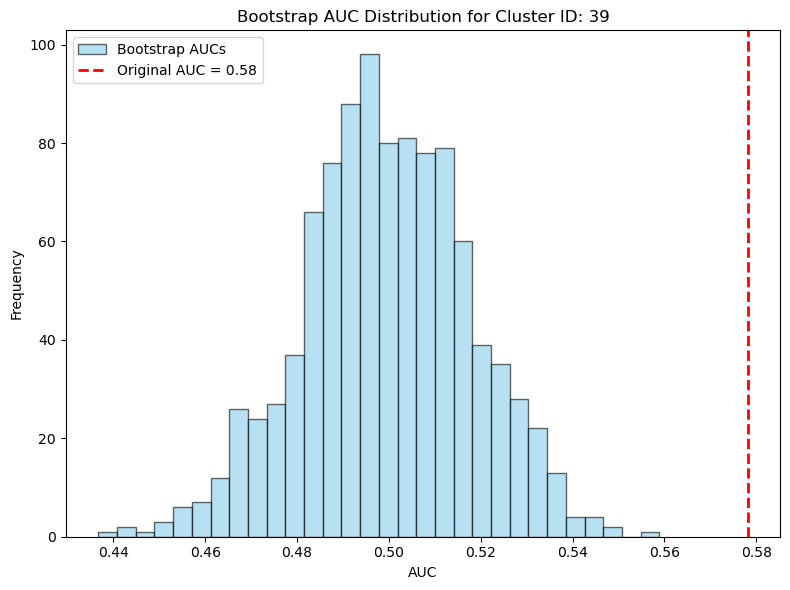

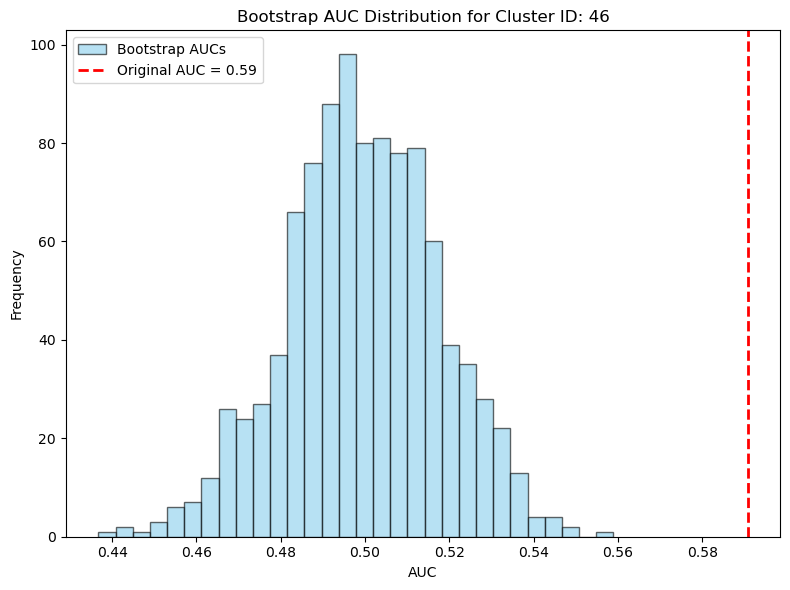

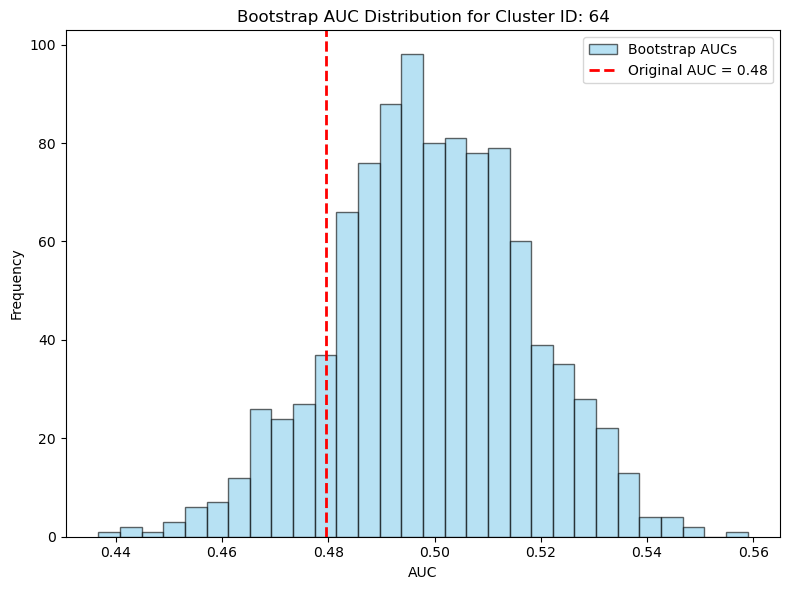

...

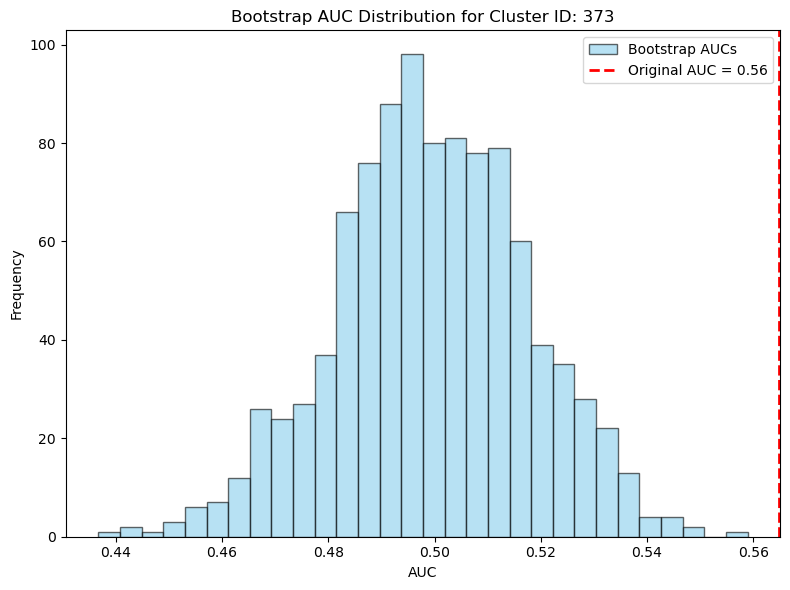

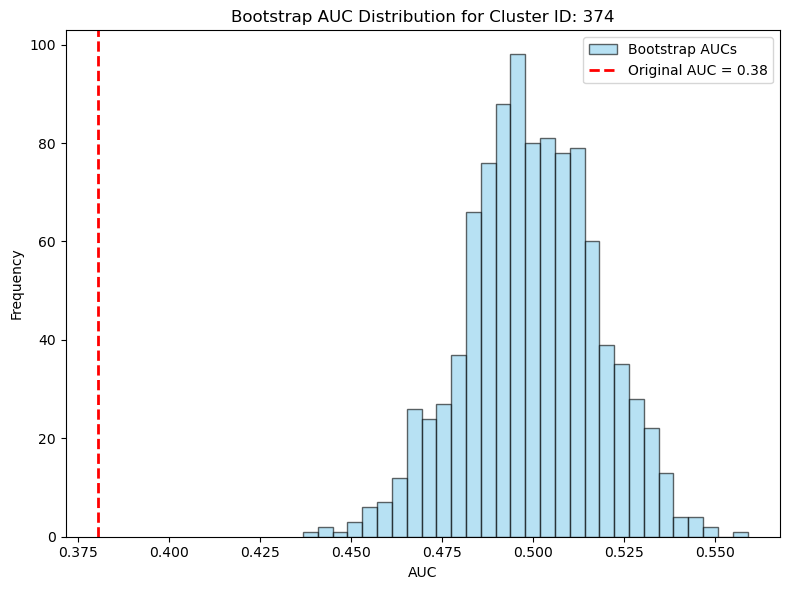

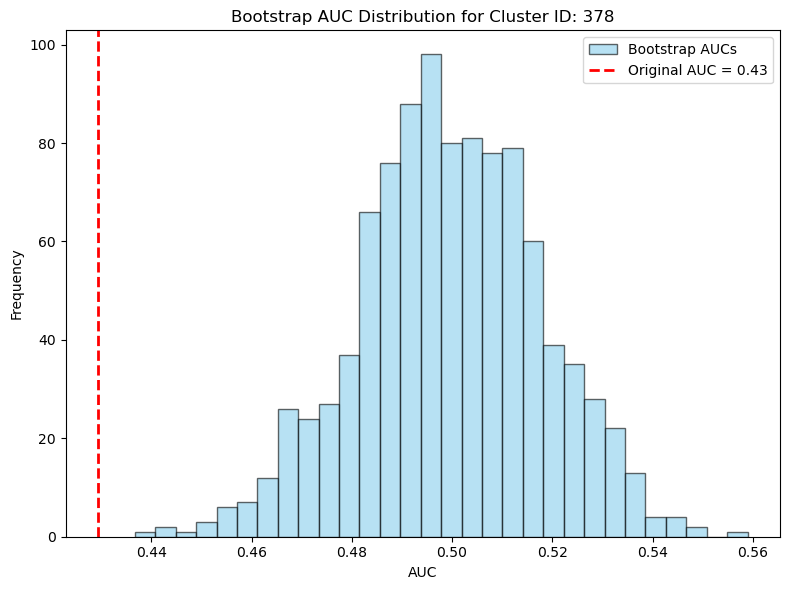

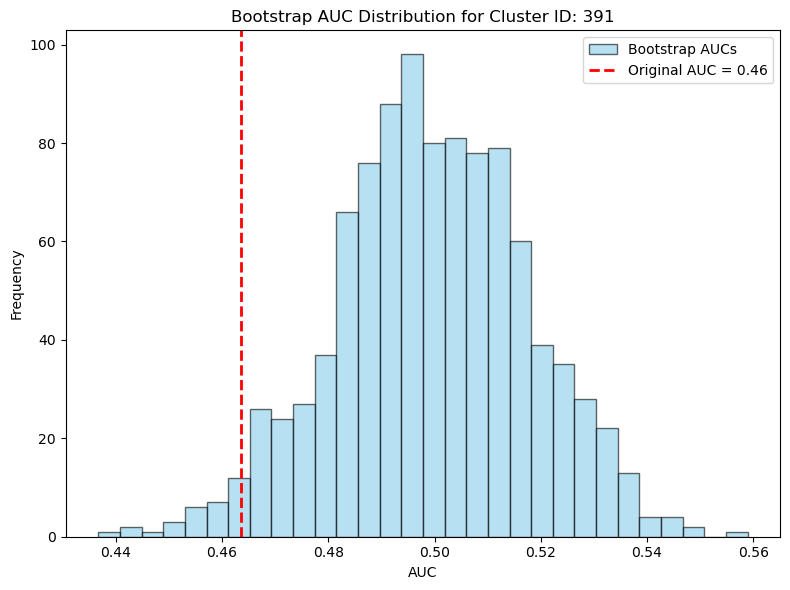

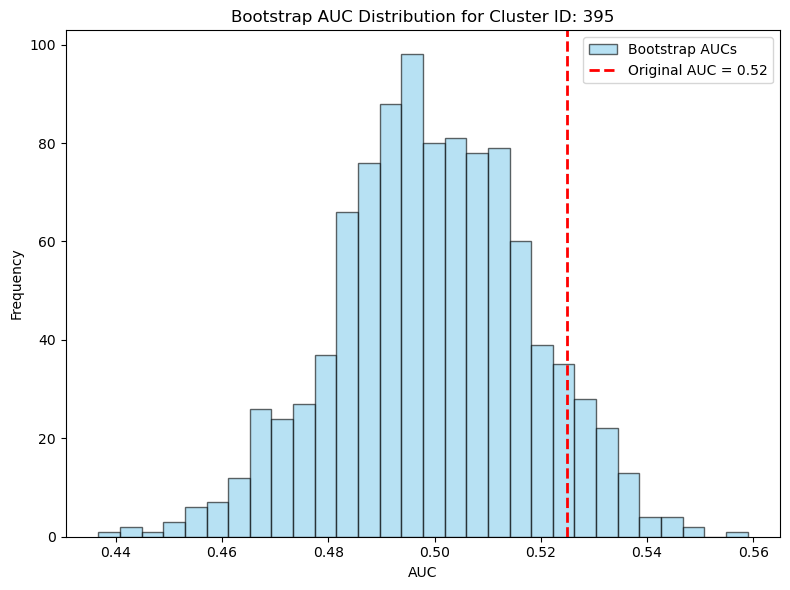

In [27]:

for i in interesting_whisker_clusters:
    plot_bootstrap_auc_distribution(bootstrap_aucs_whisker, original_aucs_whisker, df["cluster_id"], i)
    

### Interesting Auditory vs Whisker plots for bootstrapping

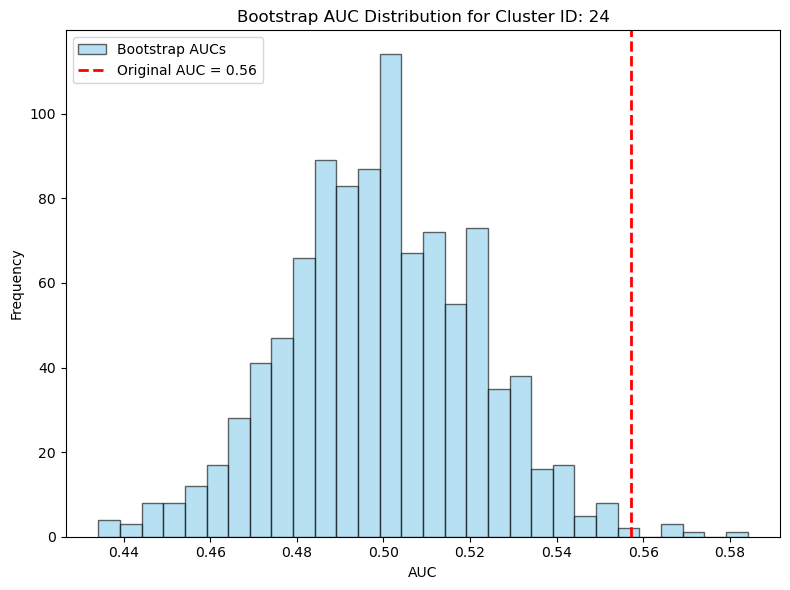

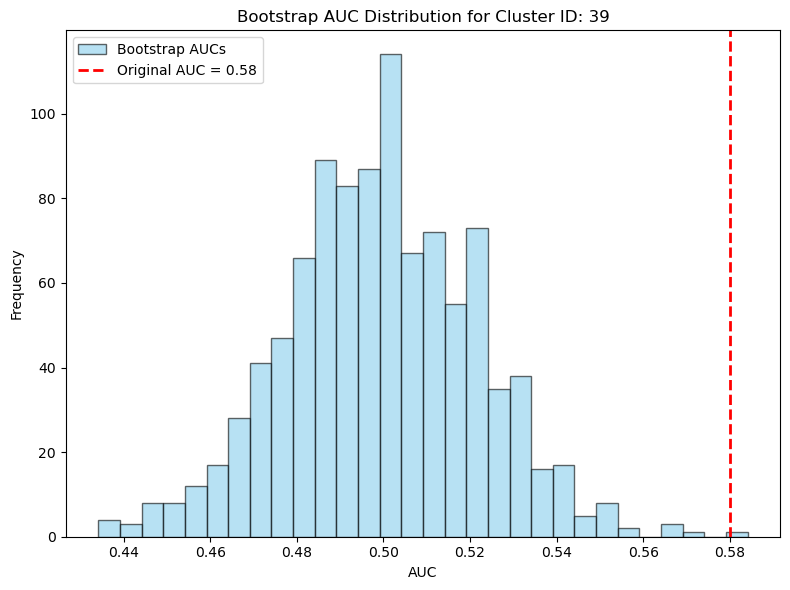

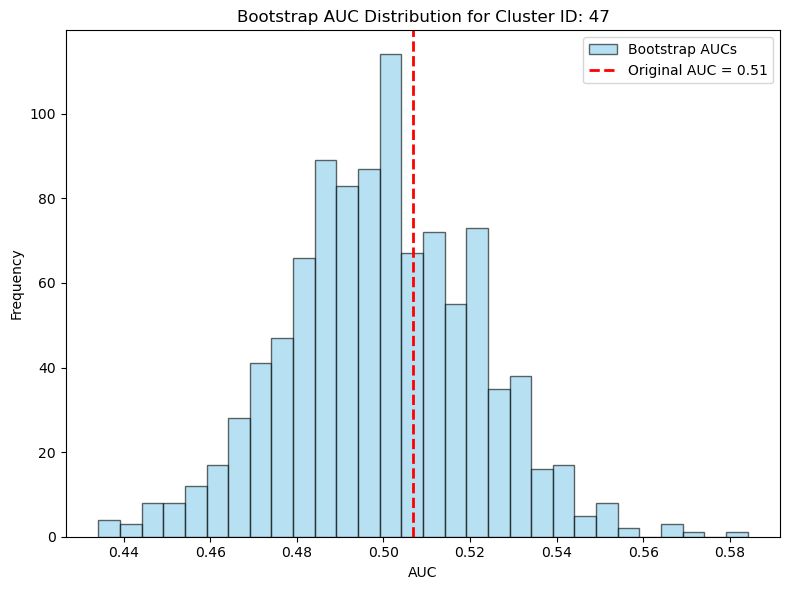

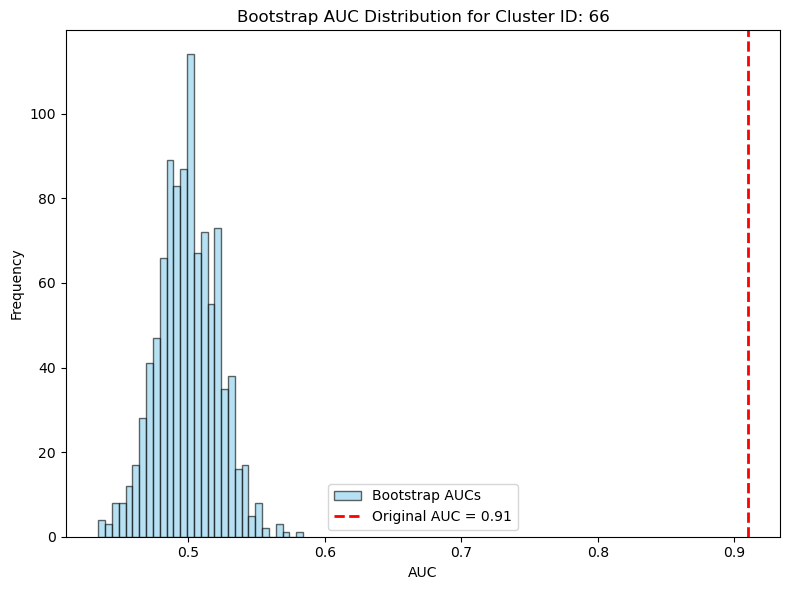

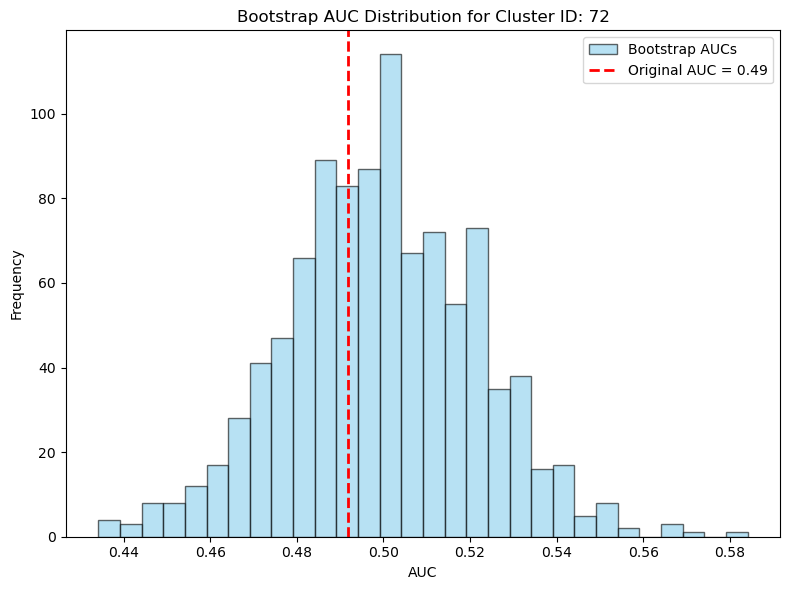

...

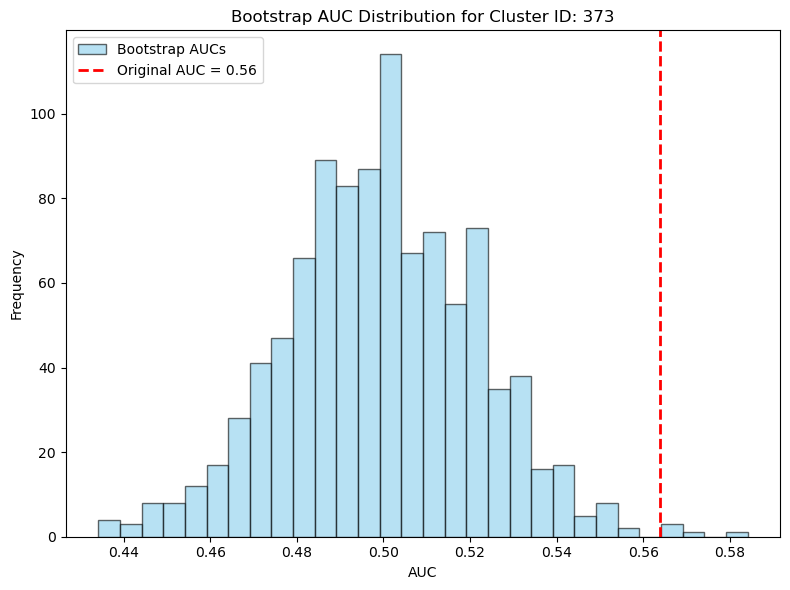

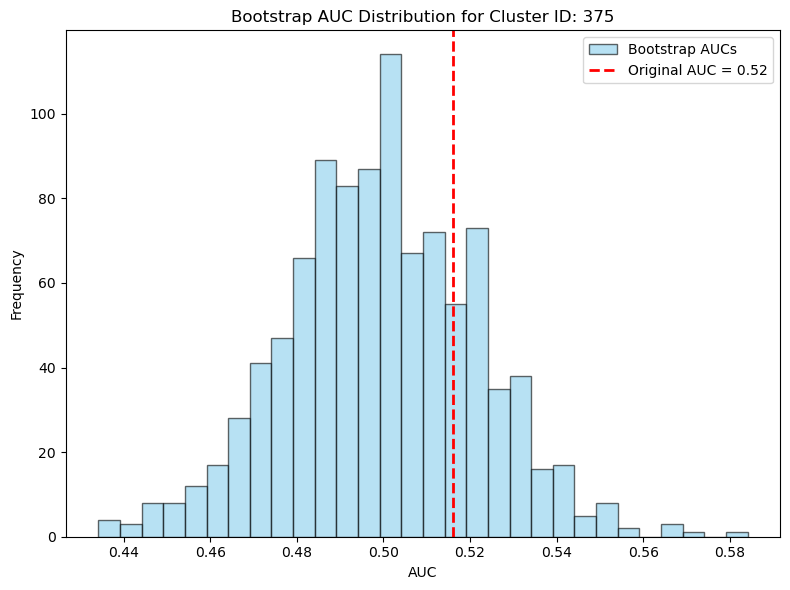

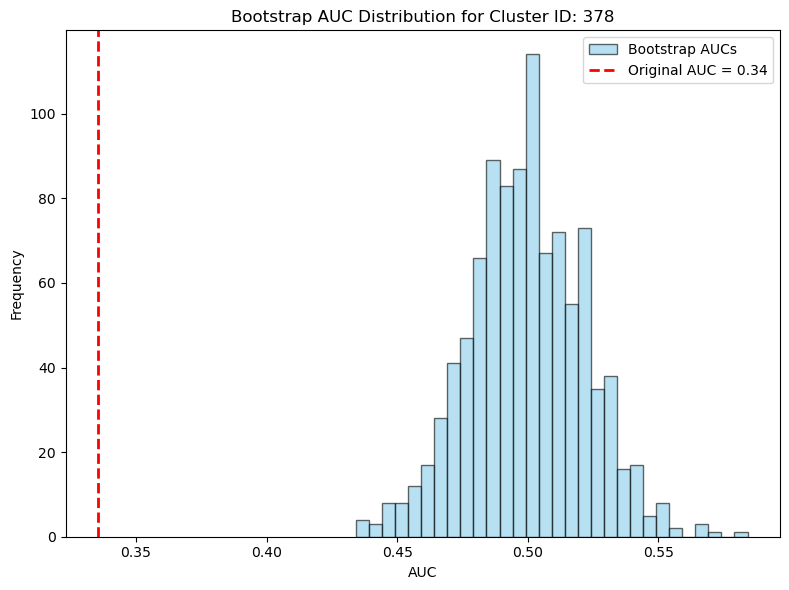

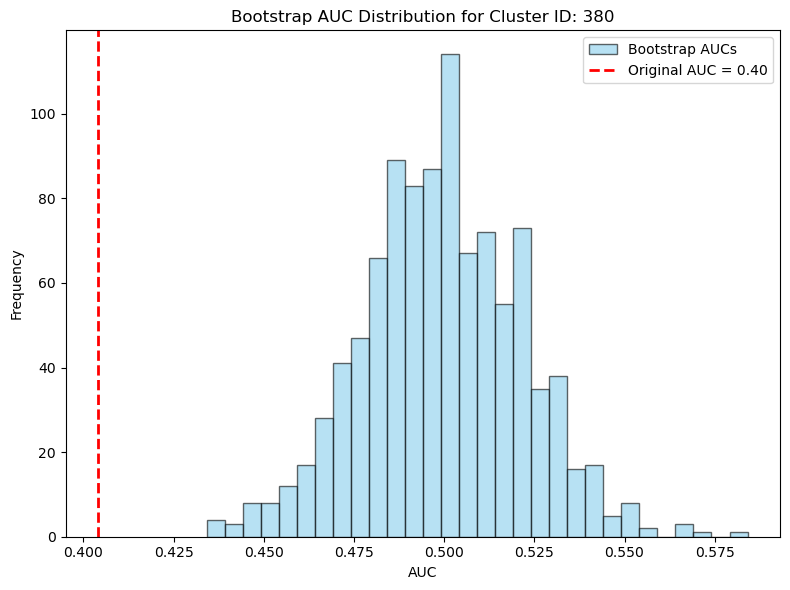

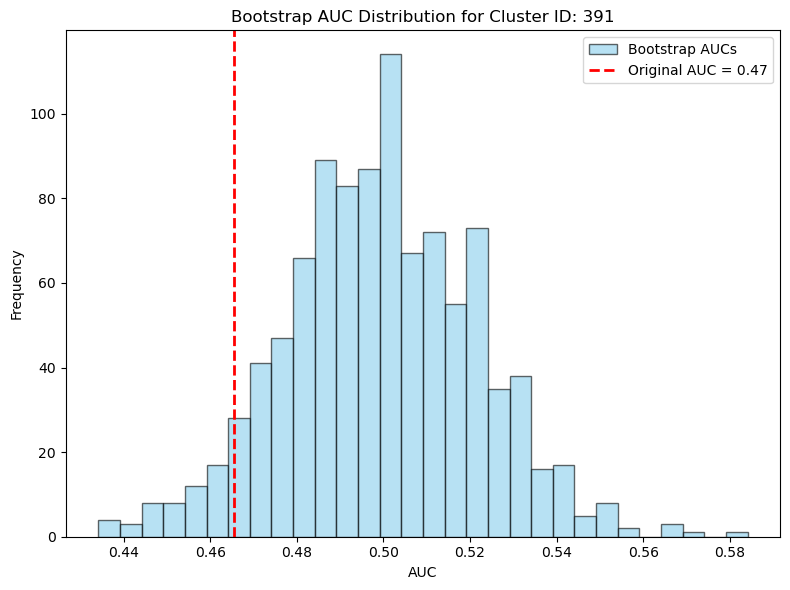

In [ ]:

for i in interesting_auditory_clusters:
    plot_bootstrap_auc_distribution(bootstrap_aucs_wh_aud, original_aucs_wh_aud, df["cluster_id"], i)

### Pivot the table

In [ ]:
df_clean = create_combined_df(df)

### Save everything

In [42]:
df_clean['Mouse name'] = mouse_name
df_clean

,cluster_id,firing_rate,ccf_acronym,ccf_name,ccf_parent_acronym,ccf_parent_name,spike_times,pre_spikes,post_spikes,pre,post,AUC,Transformed AUC,p-values positive,p-values negative,selective,direction,event,Mouse name
0,1,4.97110188,ACAv5,"Anterior cingulate area, ventral part, layer 5",ACAv,"Anterior cingulate area, ventral part","[0.479889, 1.1120556666666668, 2.586543, 4.527...","[0, 0, 2, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, ...","[0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 2, 1, ...",0.2,0.2,0.535941,0.071882,0.800,0.200,False,none,whisker,AB077_20230531_143839
1,3,0.14528229,ACAv5,"Anterior cingulate area, ventral part, layer 5",ACAv,"Anterior cingulate area, ventral part","[7.349212333333333, 36.45573866666666, 56.7888...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.2,0.2,0.499093,-0.001814,0.885,0.505,False,none,whisker,AB077_20230531_143839
2,4,3.30061586,ACAv5,"Anterior cingulate area, ventral part, layer 5",ACAv,"Anterior cingulate area, ventral part","[0.680589, 2.2582096666666667, 2.8338096666666...","[3, 3, 1, 0, 2, 0, 0, 1, 1, 0, 2, 1, 0, 0, 0, ...","[1, 2, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, ...",0.2,0.2,0.515306,0.030612,0.001,1.000,True,positive,whisker,AB077_20230531_143839
3,6,0.71495552,ACAv5,"Anterior cingulate area, ventral part, layer 5",ACAv,"Anterior cingulate area, ventral part","[0.17062233333333332, 15.114042666666668, 22.1...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.2,0.2,0.482426,-0.035147,0.082,0.974,False,none,whisker,AB077_20230531_143839
4,7,4.93621331,ACAv5,"Anterior cingulate area, ventral part, layer 5",ACAv,"Anterior cingulate area, ventral part","[0.004989000000000021, 0.102989, 0.155489, 0.3...","[3, 1, 3, 1, 1, 2, 3, 2, 1, 0, 1, 2, 0, 1, 0, ...","[1, 1, 1, 0, 1, 0, 1, 0, 2, 1, 1, 0, 0, 1, 2, ...",0.2,0.2,0.570975,0.141950,0.059,0.943,False,none,whisker,AB077_20230531_143839
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2223,719,0.1002392,SSp-bfd6a,"Primary somatosensory area, barrel field, laye...",SSp-bfd,"Primary somatosensory area, barrel field","[87.81333416852802, 161.4544207068485, 179.951...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.2,0.2,0.494444,-0.011111,0.620,0.746,False,none,lick_stim,AB077_20230531_143839
2224,720,0.51082935,SSp-bfd5,"Primary somatosensory area, barrel field, layer 5",SSp-bfd,"Primary somatosensory area, barrel field","[0.05410021605180648, 0.2121312593676502, 0.32...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.2,0.2,0.461111,-0.077778,0.491,0.132,False,none,lick_stim,AB077_20230531_143839
2225,722,0.10544643,SSp-bfd2/3,"Primary somatosensory area, barrel field, laye...",SSp-bfd,"Primary somatosensory area, barrel field","[15.397901203225924, 30.19794473615663, 47.709...","[0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.2,0.2,0.504649,0.009297,0.608,0.968,False,none,lick_stim,AB077_20230531_143839
2226,725,0.2762436,SSp-bfd6a,"Primary somatosensory area, barrel field, laye...",SSp-bfd,"Primary somatosensory area, barrel field","[0.7999227417198097, 1.057052349004859, 1.1213...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.2,0.2,0.523243,0.046485,0.522,0.631,False,none,lick_stim,AB077_20230531_143839


In [20]:
# Create a new dataframe 

#df_clean.to_csv(f'{mouse_name}_AUC_Selectivity.csv', index=True, header=True)
#df_clean.to_pickle(f'{mouse_name}_AUC_Selectivity.pkl')
df_clean.to_parquet(f'{mouse_name}_AUC_Selectivity.parquet', index=False)